In [68]:
%matplotlib inline

import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import plotly.express as px
from scipy.stats import linregress
import plotly.graph_objects as go

In [69]:
# Display the data
life_expectancy = Path("../output/csv/master_dataset.csv")
life_expectancy_df = pd.read_csv(life_expectancy, low_memory=False)
display(life_expectancy_df)

,Country,Year,Life Expectancy,Population,Type,"Male Population, as of 1 July (thousands)","Female Population, as of 1 July (thousands)",Male Life Expectancy at Birth (years),Female Life Expectancy at Birth (years),countrycode,...,Alcohol use disorders,Cardiovascular diseases,Diabetes mellitus,Liver cancer due to alcohol use,Motor vehicle road injuries,Opioid use disorders,Police conflict and executions,Road injuries,Self-harm,"Tracheal, bronchus, and lung cancer"
0,Afghanistan,1950.0,27.7,7480,Country/Area,3962.0,3518.0,27.1,28.4,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,1951.0,28.0,7572,Country/Area,4002.0,3570.0,27.4,28.6,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,1952.0,28.4,7668,Country/Area,4043.0,3624.0,27.8,29.1,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,1953.0,28.9,7765,Country/Area,4086.0,3679.0,28.3,29.6,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,1954.0,29.2,7864,Country/Area,4129.0,3735.0,28.6,29.9,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17059,Zimbabwe,2017.0,60.7,14751,Country/Area,6941.0,7810.0,58.2,63.0,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17060,Zimbabwe,2018.0,61.4,15052,Country/Area,7086.0,7966.0,59.0,63.6,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17061,Zimbabwe,2019.0,61.3,15355,Country/Area,7232.0,8123.0,58.6,63.7,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17062,Zimbabwe,2020.0,61.1,15670,Country/Area,7385.0,8284.0,58.1,63.9,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [70]:
# Display columns to help in choosing variables of interest
columns_df = pd.DataFrame(life_expectancy_df.columns)
display(columns_df)

,0
0,Country
1,Year
2,Life Expectancy
3,Population
4,Type
5,"Male Population, as of 1 July (thousands)"
6,"Female Population, as of 1 July (thousands)"
7,Male Life Expectancy at Birth (years)
8,Female Life Expectancy at Birth (years)
9,countrycode


In [71]:
# Remove the rows with missing values in GDP Per Capita
cleaned_df = life_expectancy_df.dropna(subset=['GDP per Capita'])
cleaned_df

,Country,Year,Life Expectancy,Population,Type,"Male Population, as of 1 July (thousands)","Female Population, as of 1 July (thousands)",Male Life Expectancy at Birth (years),Female Life Expectancy at Birth (years),countrycode,...,Alcohol use disorders,Cardiovascular diseases,Diabetes mellitus,Liver cancer due to alcohol use,Motor vehicle road injuries,Opioid use disorders,Police conflict and executions,Road injuries,Self-harm,"Tracheal, bronchus, and lung cancer"
0,Afghanistan,1950.0,27.7,7480,Country/Area,3962.0,3518.0,27.1,28.4,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,1951.0,28.0,7572,Country/Area,4002.0,3570.0,27.4,28.6,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,1952.0,28.4,7668,Country/Area,4043.0,3624.0,27.8,29.1,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,1953.0,28.9,7765,Country/Area,4086.0,3679.0,28.3,29.6,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,1954.0,29.2,7864,Country/Area,4129.0,3735.0,28.6,29.9,AFG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17059,Zimbabwe,2017.0,60.7,14751,Country/Area,6941.0,7810.0,58.2,63.0,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17060,Zimbabwe,2018.0,61.4,15052,Country/Area,7086.0,7966.0,59.0,63.6,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17061,Zimbabwe,2019.0,61.3,15355,Country/Area,7232.0,8123.0,58.6,63.7,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17062,Zimbabwe,2020.0,61.1,15670,Country/Area,7385.0,8284.0,58.1,63.9,ZWE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [72]:
# Only copy colums which are needed for the analysis
final_df = cleaned_df[['Country', 'Year', 'Life Expectancy', 'GDP per Capita', 'Region', 'Population']].copy()

# Reset index
final_df.reset_index(drop=True, inplace=True)

final_df

,Country,Year,Life Expectancy,GDP per Capita,Region,Population
0,Afghanistan,1950.0,27.7,1156.0,South and South East Asia,7480
1,Afghanistan,1951.0,28.0,1170.0,South and South East Asia,7572
2,Afghanistan,1952.0,28.4,1189.0,South and South East Asia,7668
3,Afghanistan,1953.0,28.9,1240.0,South and South East Asia,7765
4,Afghanistan,1954.0,29.2,1245.0,South and South East Asia,7864
...,...,...,...,...,...,...
11216,Zimbabwe,2017.0,60.7,1844.0,Sub Saharan Africa,14751
11217,Zimbabwe,2018.0,61.4,1900.0,Sub Saharan Africa,15052
11218,Zimbabwe,2019.0,61.3,1753.0,Sub Saharan Africa,15355
11219,Zimbabwe,2020.0,61.1,1586.0,Sub Saharan Africa,15670


In [73]:
#Show Data types to check if data types need to be changed
final_df.dtypes

Country             object
Year               float64
Life Expectancy    float64
GDP per Capita     float64
Region              object
Population           int64
dtype: object

In [74]:
# Modify Datatype as needed
final_df['Year'] = final_df['Year'].astype("int")
final_df

,Country,Year,Life Expectancy,GDP per Capita,Region,Population
0,Afghanistan,1950,27.7,1156.0,South and South East Asia,7480
1,Afghanistan,1951,28.0,1170.0,South and South East Asia,7572
2,Afghanistan,1952,28.4,1189.0,South and South East Asia,7668
3,Afghanistan,1953,28.9,1240.0,South and South East Asia,7765
4,Afghanistan,1954,29.2,1245.0,South and South East Asia,7864
...,...,...,...,...,...,...
11216,Zimbabwe,2017,60.7,1844.0,Sub Saharan Africa,14751
11217,Zimbabwe,2018,61.4,1900.0,Sub Saharan Africa,15052
11218,Zimbabwe,2019,61.3,1753.0,Sub Saharan Africa,15355
11219,Zimbabwe,2020,61.1,1586.0,Sub Saharan Africa,15670


In [75]:
# Specify the file path where you want to save the CSV file
csv_file_path = '../output/csv/life_and_gdp.csv'

# Write final_df to CSV
final_df.to_csv(csv_file_path, index=False)

print(f"DataFrame successfully written to {csv_file_path}")

DataFrame successfully written to ../output/csv/life_and_gdp.csv


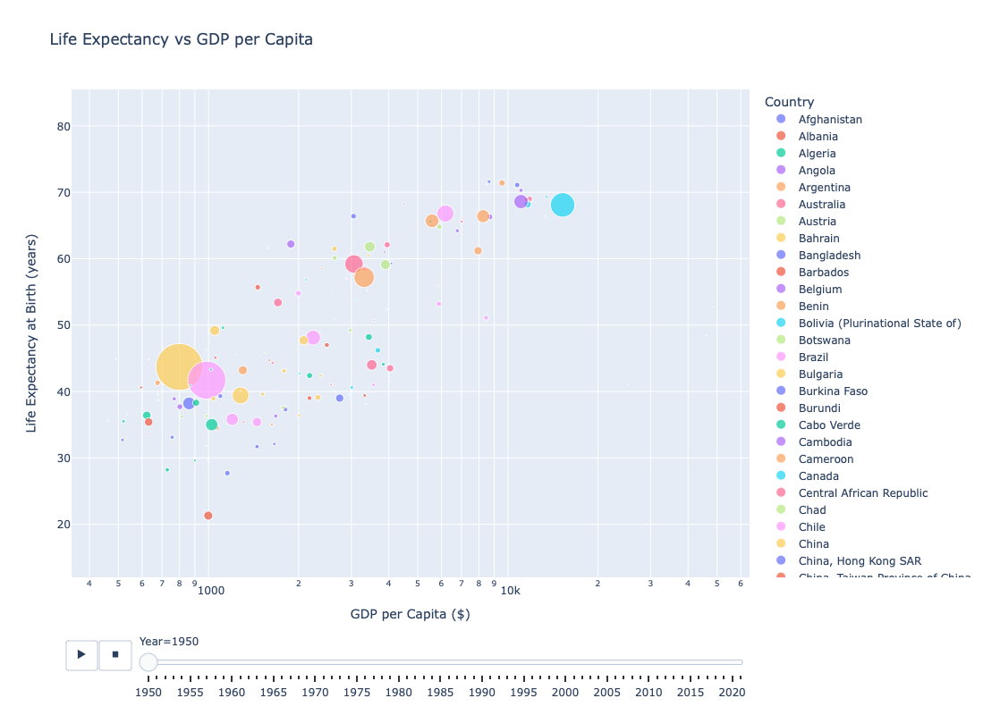

In [76]:
# Create the scatter plot for Life Expectancy vs GDP per Capita 
fig = px.scatter(
    final_df,
    x='GDP per Capita',
    y='Life Expectancy',
    size='Population',
    #color='Region',
    color='Country',
    animation_frame='Year',
    animation_group='Country',
    hover_name='Country',
    log_x=True,
    size_max=60,
    title='Life Expectancy vs GDP per Capita',
    labels={
        'Life Expectancy': 'Life Expectancy at Birth (years)',
        'GDP per Capita': 'GDP per Capita ($)',
        'Population': 'Population (thousands)'
    }
)

# Set the range for x-axis and y-axis
#x_range = [final_df['GDP per Capita'].min(), final_df['GDP per Capita'].max()]
y_range = [final_df['Life Expectancy'].min(), final_df['Life Expectancy'].max()]

#fig.update_xaxes(range=x_range)
fig.update_yaxes(range=y_range)

# Update the layout to set the size
fig.update_layout(
    width=1100,  # Set the width to 1000 pixels
    height=800   # Set the height to 600 pixels
)

# Save the figure as an HTML file
fig.write_html("../output/graphs/Fig1.html")

# Show the plot
fig.show()

In [77]:
# Get the data just for the year 2021 to show how life expectancy compares between wealthy and poor countries
data2021_df = final_df[final_df['Year'] == 2021]

# Sorting and selecting top 10 and bottom 10 countries by GDP per capita
top_5_gdp = data2021_df.nlargest(10, 'GDP per Capita')
bottom_5_gdp = data2021_df.nsmallest(10, 'GDP per Capita')

# Combining the top 5 and bottom 5 into a single DataFrame
gdp_df = pd.concat([top_5_gdp, bottom_5_gdp])
gdp_df

,Country,Year,Life Expectancy,GDP per Capita,Region,Population
8382,Qatar,2021,79.3,143469.0,Middle East and North Africa,2688
7662,Norway,2021,83.2,86335.0,Western Europe,5403
9287,Singapore,2021,82.8,77945.0,South and South East Asia,5941
10529,United Arab Emirates,2021,78.7,72460.0,Middle East and North Africa,9365
5593,Kuwait,2021,78.7,66418.0,Middle East and North Africa,4250
9826,Switzerland,2021,84.0,62595.0,Western Europe,8691
10745,United States,2021,77.2,57523.0,Western Offshoots,336998
5046,Ireland,2021,82.0,57278.0,Western Europe,4987
6082,Luxembourg,2021,82.6,55347.0,Western Europe,639
2214,"China, Taiwan Province of China",2021,81.0,51944.0,East Asia,23860


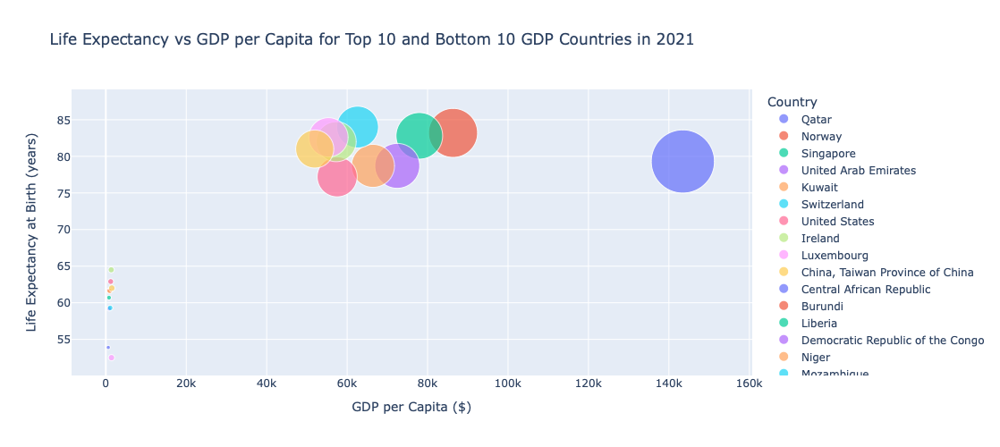

In [78]:
# Create the scatter plot for year 2021 to show how life expectancy compares between wealthy and poor countries

fig = px.scatter(
    gdp_df,
    x='GDP per Capita',
    y='Life Expectancy',
    color='Country',
    #size='Population',
    size='GDP per Capita',
    hover_name='Country',
    title='Life Expectancy vs GDP per Capita for Top 10 and Bottom 10 GDP Countries in 2021',
    labels={'GDP per Capita': 'GDP per Capita ($)', 'Life Expectancy': 'Life Expectancy at Birth (years)'},
    size_max=50
)
# Update the layout to set the size
fig.update_layout(
    width=1000,  # Set the width to 1000 pixels
    height=500   # Set the height to 500 pixels
)

# Save the figure as an HTML file
fig.write_html("../output/graphs/Fig2.html")

# Show the plot
fig.show()

The correlation between GDP per Capita and Life Expectancy is 0.7
The r-squared value is: 0.49214849084893353


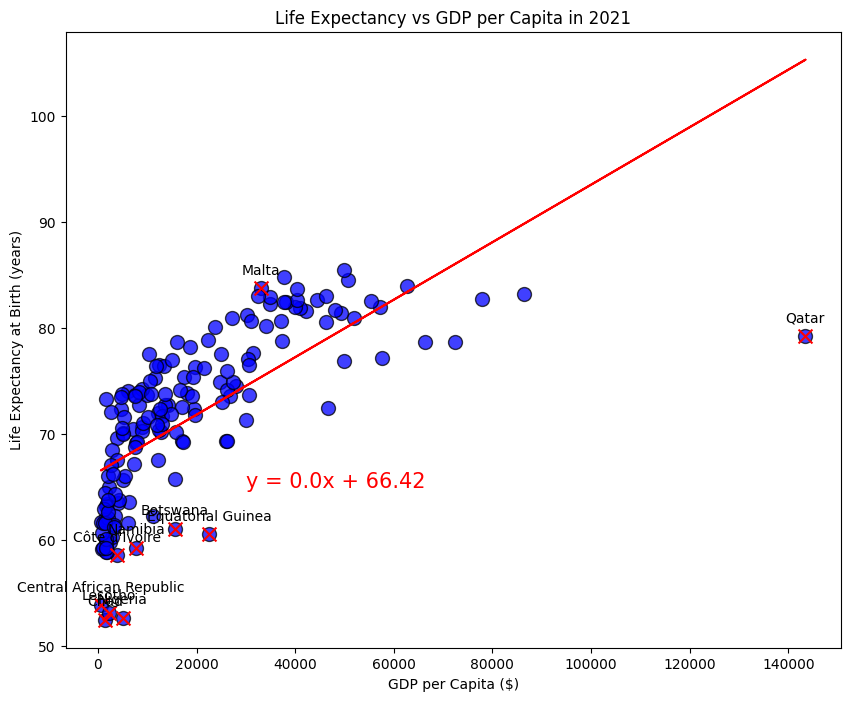

In [79]:
# Calculate the correlation coefficient and a linear regression model 
# for GDP Per Capita and Life Expectancy for the year 2021
x_values = data2021_df['GDP per Capita']
y_values = data2021_df['Life Expectancy']
(slope, intercept, rvalue, pvalue, stderr) = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))

# Calculate residuals
residuals = y_values - regress_values

# Define a threshold for outliers (e.g., 1.5 times the standard deviation of residuals)
threshold = 1.5 * residuals.std()
outliers = data2021_df[abs(residuals) > threshold]

plt.figure(figsize=(10, 8))
plt.scatter(x_values, y_values, marker='o', facecolors='blue', edgecolors='black', s=100, alpha=0.75, label='Data Points')
plt.plot(x_values,regress_values,"r-", label='Regression Line')

# Highlight outliers
plt.scatter(outliers['GDP per Capita'], outliers['Life Expectancy'], marker='x', color='red', s=100, label='Outliers')

# Annotate the outliers
for idx, row in outliers.iterrows():
    plt.annotate(row['Country'], (row['GDP per Capita'], row['Life Expectancy']), textcoords="offset points", xytext=(0, 10), ha='center')

plt.title('Life Expectancy vs GDP per Capita in 2021')
plt.annotate(line_eq,(30000,65),fontsize=15,color="red")
plt.xlabel('GDP per Capita ($)')
plt.ylabel('Life Expectancy at Birth (years)')
print(f'The correlation between GDP per Capita and Life Expectancy is {round(rvalue, 2)}')
print(f"The r-squared value is: {rvalue**2}")
# Save the figure
plt.savefig("../output/graphs/Fig3.png")
#Show the plot
plt.show()

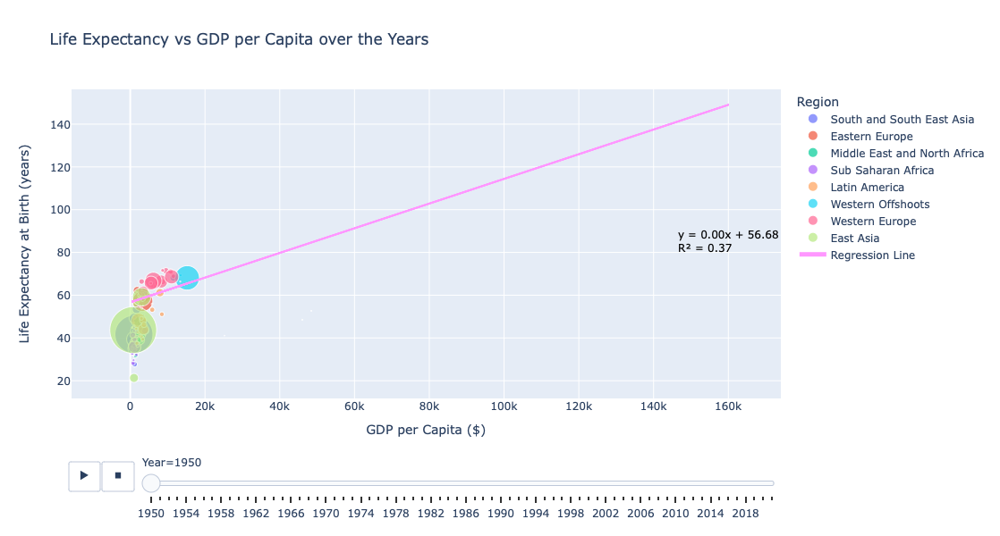

In [80]:
# Calculate linear regression for all years 
slope, intercept, r_value, p_value, std_err = linregress(final_df['GDP per Capita'], final_df['Life Expectancy'])

# Create regression line
final_df['Regression Line'] = slope * final_df['GDP per Capita'] + intercept

# Create the scatter plot with regression line
fig = px.scatter(
    final_df,
    x='GDP per Capita',
    y='Life Expectancy',
    animation_frame='Year',
    animation_group='Country',
    color='Region',
    size='Population',
    hover_name='Country',
    title='Life Expectancy vs GDP per Capita over the Years',
    labels={'GDP per Capita': 'GDP per Capita ($)', 'Life Expectancy': 'Life Expectancy at Birth (years)'},
    size_max=60
)

# Add regression line to the plot
fig.add_trace(
    go.Scatter(
        x=final_df['GDP per Capita'],
        y=final_df['Regression Line'],
        mode='lines',
        name='Regression Line'
    )
)

# Add annotation for the regression line equation and r-value
equation = f'y = {slope:.2f}x + {intercept:.2f}'
r_squared = f'R² = {r_value**2:.2f}'
fig.add_annotation(
    x=final_df['GDP per Capita'].max(),
    y=final_df['Life Expectancy'].max(),
    text=f'{equation}<br>{r_squared}',
    showarrow=False,
    font=dict(size=12, color='black'),
    align='left'
)
# Update the layout to set the size
fig.update_layout(
    width=1000,  # Set the width to 1000 pixels
    height=600   # Set the height to 600 pixels
)

# Save the figure as an HTML file
fig.write_html("../output/graphs/Fig4.html")

# Show the plot
fig.show()

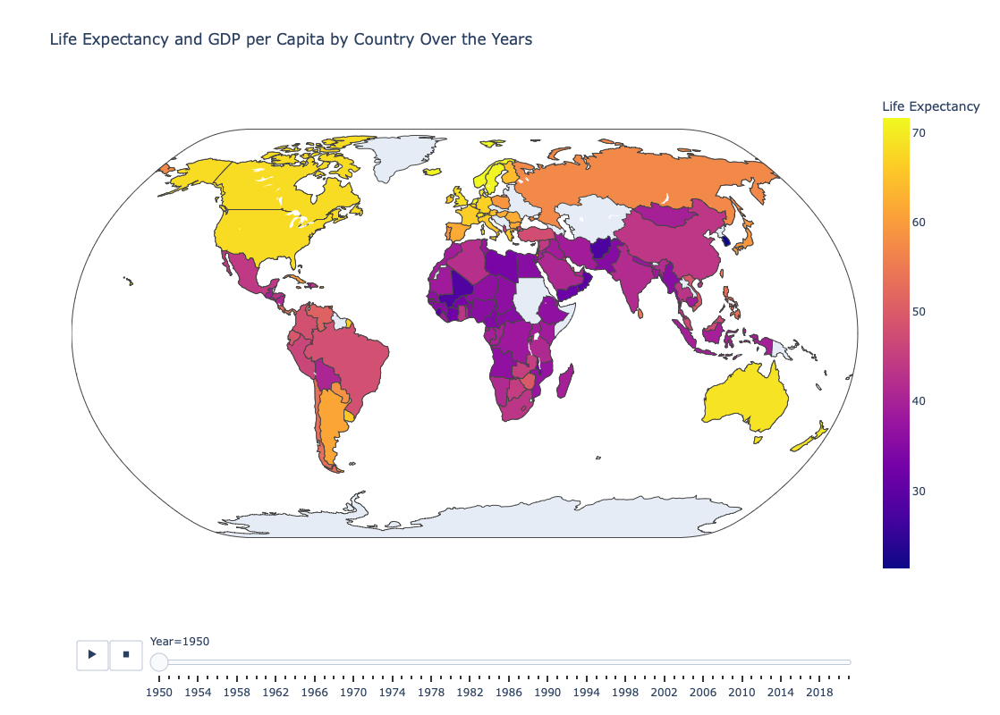

In [81]:
# Create the choropleth map to show Life Expectancy and GDP per Capita by Country Over the Years
fig = px.choropleth(
    final_df,
    locations='Country',
    locationmode='country names',
    color='Life Expectancy',
  #  color='GDP per Capita',
    hover_name='Country',
    hover_data={
        'Life Expectancy': True,
        'GDP per Capita': True,
        'Year': True,
        'Population': True,
        'Country': False  # To avoid redundancy as hover_name already includes it
    },
    animation_frame='Year',
    projection='natural earth',
    title='Life Expectancy and GDP per Capita by Country Over the Years',
    color_continuous_scale=px.colors.sequential.Plasma
)

# Update the layout to set the size
fig.update_layout(
    width=1100,  # Set the width to 1000 pixels
    height=800   # Set the height to 800 pixels
)
# Save the figure as an HTML file
fig.write_html("../output/graphs/Fig5.html")

# Show the plot
fig.show()